# Depth Anything 3 (DA3) Usage Example

This notebook demonstrates how to use Depth Anything 3 for camera poses and depth estimation.


In [2]:
import os 
#set CUDA visible devices to 1
os.environ["CUDA_VISIBLE_DEVICES"] = "0"


In [3]:
# Install required packages
# !pip install depth-anything-3

In [4]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from depth_anything_3.api import DepthAnything3
from depth_anything_3.utils.visualize import visualize_depth
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# model = DepthAnything3.from_pretrained("depth-anything/DA3NESTED-GIANT-LARGE")
# model = model.to(device)
# model.eval()
# print(f"Model loaded on {device}")


In [5]:
def plot_pred(prediction,title=None):
    n_images=min(5, len(prediction.depth))

    fig, axes = plt.subplots(2, n_images, figsize=(12, 6))
    if n_images == 1:
        axes = axes.reshape(2, 1)


    for i in range(n_images):
        # Show original image
        if prediction.processed_images is not None:
            axes[0, i].imshow(prediction.processed_images[i])
        axes[0, i].set_title(f"Input {i+1}")
        axes[0, i].axis('off')
        
        # Show depth map
        depth_vis = visualize_depth(prediction.depth[i], cmap="Spectral")
        axes[1, i].imshow(depth_vis)
        axes[1, i].set_title(f"Depth {i+1}")
        axes[1, i].axis('off')

    fig.suptitle(title)
    plt.tight_layout()
    plt.show()
visualize_image=plot_pred

In [6]:
visualize_image=plot_pred

# Impact profondeur modèle

In [7]:
liste_modèle={"NESTED GIANT":"depth-anything/DA3NESTED-GIANT-LARGE",
              "Giant":"depth-anything/DA3-GIANT",
                " Large":"depth-anything/DA3-LARGE",
                "Base":"depth-anything/DA3-BASE",
                "Small":"depth-anything/DA3-SMALL",
                "Metric large":"depth-anything/DA3METRIC-LARGE"}
# Metric large?

In [8]:
def visualize_image_grid(model_results, image_paths, row_titles):
    """
    model_results: list of predictions from different models
    row_titles: ["Input", model1_name, model2_name, ...]
    image_paths: list of image paths
    """

    n_models = len(model_results)
    n_images = len(image_paths)

    fig, axes = plt.subplots(
        n_models + 1, n_images,
        figsize=(4 * n_images, 2.8 * (n_models + 1))
    )

    if (n_models + 1) == 1:
        axes = axes.reshape(1, n_images)
    if n_images == 1:
        axes = axes.reshape(n_models + 1, 1)

    # ----- Row 0 : Input images -----
    for i in range(n_images):
        axes[0, i].imshow(model_results[0].processed_images[i])
        axes[0, i].axis("off")
        axes[0, i].set_title(f"Image {i+1}")

    # ----- Rows 1..N : Predicted depths -----
    for model_idx, pred in enumerate(model_results):
        row = model_idx + 1
        for i in range(n_images):
            depth_vis = visualize_depth(pred.depth[i], cmap="Spectral")
            axes[row, i].imshow(depth_vis)
            axes[row, i].axis("off")

    # ----------------------------------------------------
    #     ADD ROW LABELS OUTSIDE THE SUBPLOT GRID
    # ----------------------------------------------------
    for row in range(n_models + 1):
        fig.text(
            0,#0.01,                                   # x position (left margin)
            1 - (row + 0.5) / (n_models + 1),       # y position
            row_titles[row],
            va="center", ha="left", fontsize=12
        )

    fig.suptitle("Depth Comparison Across Models", fontsize=18, y=0.995)
    fig.tight_layout(rect=[0.06, 0, 1, 0.98])     # leave space for row labels
    plt.show()


model name: depth-anything/DA3NESTED-GIANT-LARGE
[INFO ] using SwiGLU layer as FFN
[INFO ] using MLP layer as FFN
[INFO ] Processed Images Done taking 0.05211067199707031 seconds. Shape:  torch.Size([2, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.218308687210083 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0009317398071289062 seconds
model name: depth-anything/DA3-GIANT
[INFO ] using SwiGLU layer as FFN
[INFO ] Processed Images Done taking 0.05128002166748047 seconds. Shape:  torch.Size([2, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.1524040699005127 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0009186267852783203 seconds
model name: depth-anything/DA3-LARGE
[INFO ] using MLP layer as FFN
[INFO ] Processed Images Done taking 0.05353045463562012 seconds. Shape:  torch.Size([2, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.08936262130737305 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0007929801940917969 seconds
model name: dep

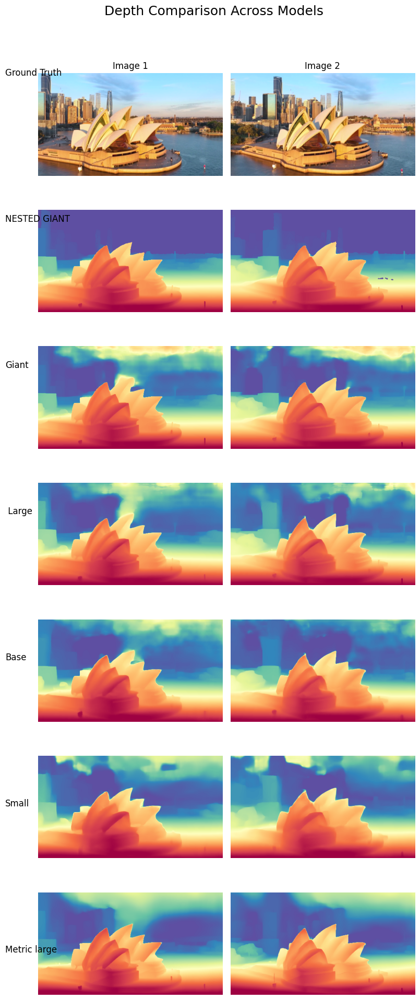

In [11]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from depth_anything_3.api import DepthAnything3
from depth_anything_3.utils.visualize import visualize_depth

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# image list
image_paths = [
    "../assets/examples/SOH/000.png",
    "../assets/examples/SOH/010.png"
]


model_results = []
row_titles = ["Ground Truth"]

for model_key in liste_modèle:
    model_name = liste_modèle[model_key]
    print("model name:", model_name)

    model = DepthAnything3.from_pretrained(model_name).to(device).eval()

    prediction = model.inference(
        image=image_paths,
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )

    model_results.append(prediction)
    row_titles.append(model_key)

# Display everything
visualize_image_grid(
    model_results=model_results,
    image_paths=image_paths,
    row_titles=row_titles
)


model name depth-anything/DA3NESTED-GIANT-LARGE
[INFO ] using SwiGLU layer as FFN
[INFO ] using MLP layer as FFN
Model loaded on cuda
[INFO ] Processed Images Done taking 0.04832744598388672 seconds. Shape:  torch.Size([2, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.2106316089630127 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0008013248443603516 seconds


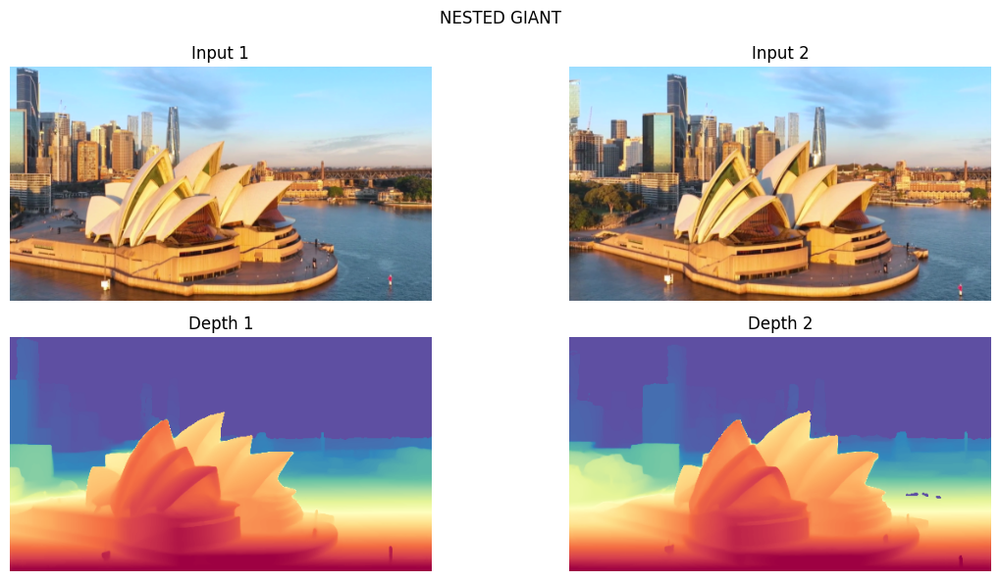

model name depth-anything/DA3-GIANT
[INFO ] using SwiGLU layer as FFN
Model loaded on cuda
[INFO ] Processed Images Done taking 0.04405546188354492 seconds. Shape:  torch.Size([2, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.15386033058166504 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0007956027984619141 seconds


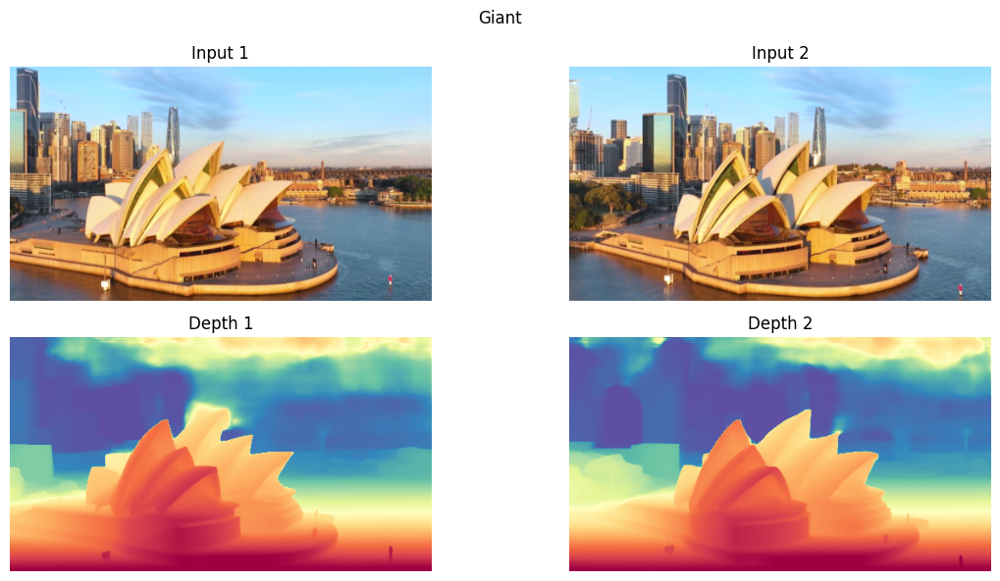

model name depth-anything/DA3-LARGE
[INFO ] using MLP layer as FFN
Model loaded on cuda
[INFO ] Processed Images Done taking 0.045305728912353516 seconds. Shape:  torch.Size([2, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.08791399002075195 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0007641315460205078 seconds


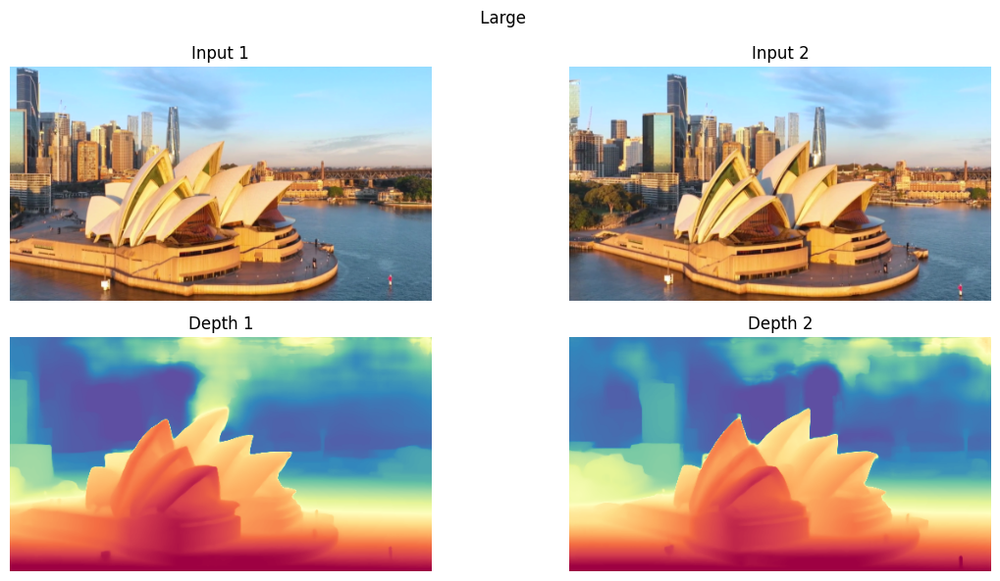

model name depth-anything/DA3-BASE
[INFO ] using MLP layer as FFN
Model loaded on cuda
[INFO ] Processed Images Done taking 0.047136545181274414 seconds. Shape:  torch.Size([2, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.04051971435546875 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0006988048553466797 seconds


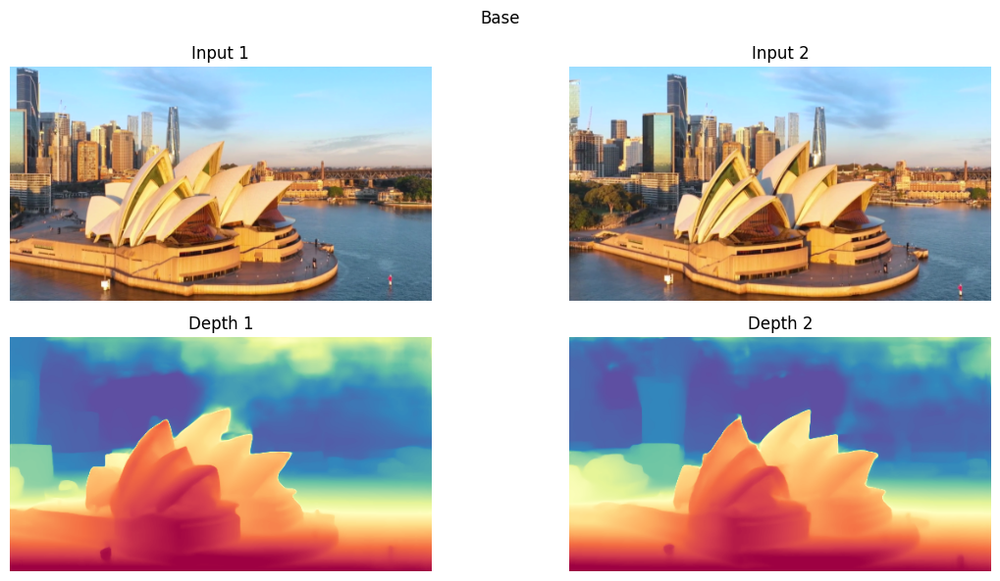

model name depth-anything/DA3-SMALL
[INFO ] using MLP layer as FFN
Model loaded on cuda
[INFO ] Processed Images Done taking 0.047853946685791016 seconds. Shape:  torch.Size([2, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.036643028259277344 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0007791519165039062 seconds


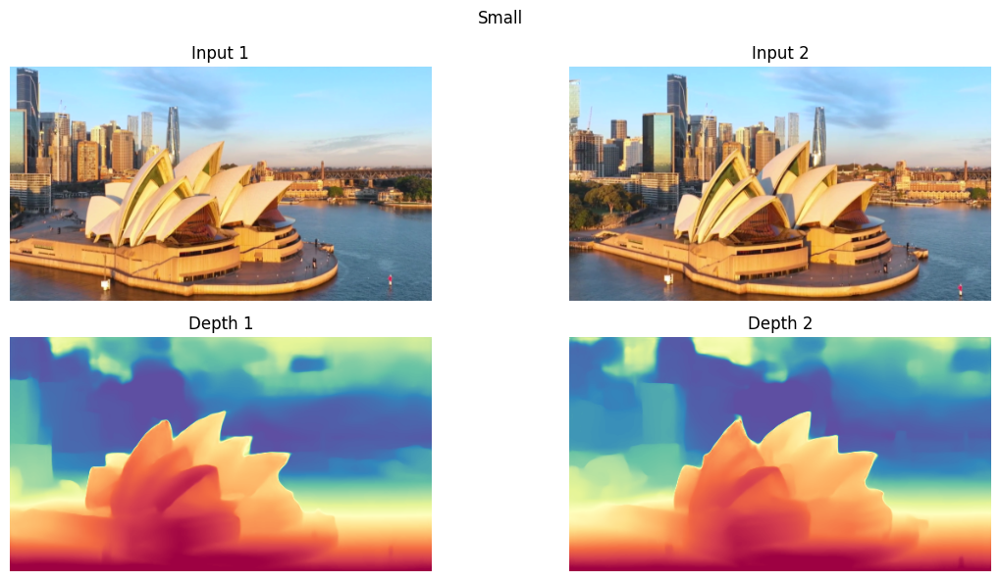

model name depth-anything/DA3METRIC-LARGE
[INFO ] using MLP layer as FFN
Model loaded on cuda
[INFO ] Processed Images Done taking 0.05612587928771973 seconds. Shape:  torch.Size([2, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.05066561698913574 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0008633136749267578 seconds


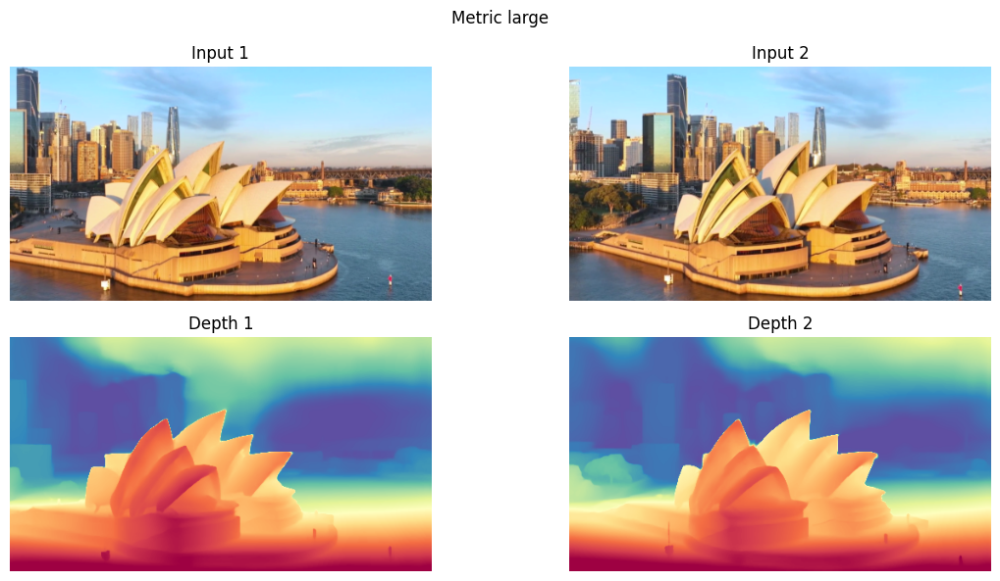

In [12]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from depth_anything_3.api import DepthAnything3
from depth_anything_3.utils.visualize import visualize_depth
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
n_images=2
for model_key in liste_modèle:

    model_name=liste_modèle[model_key]
    print("model name",model_name)

    model = DepthAnything3.from_pretrained(model_name)
    model = model.to(device)
    model.eval()
    print(f"Model loaded on {device}")

    # Load sample images and run inference
    image_paths = [
        "../assets/examples/SOH/000.png",
        "../assets/examples/SOH/010.png"
    ]

    # Run inference
    prediction = model.inference(
        image=image_paths,
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )

    visualize_image(prediction=prediction,title=model_key)

# Impact nomber images

In [13]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from depth_anything_3.api import DepthAnything3
from depth_anything_3.utils.visualize import visualize_depth
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DepthAnything3.from_pretrained("depth-anything/DA3NESTED-GIANT-LARGE")
model = model.to(device)
model.eval()
print(f"Model loaded on {device}")


[INFO ] using SwiGLU layer as FFN
[INFO ] using MLP layer as FFN
Model loaded on cuda


## Cas JAX 068

In [14]:
image_folder="/workspaces/external_datasets/satnerf/DFC2019/Track3-NEW-crops/JAX_068"
import iio 
import os 
import numpy as np
import matplotlib.pyplot as plt
    # list all .tif files in the folder
def load_img(n_images, image_folder):
    image_paths = [os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith('.tif')]
    image_paths
    images=[]
    images_name=[]
    for image_path in image_paths:
        image=iio.read(image_path)
        image = (image).astype(np.uint8) if image.dtype != np.uint8 else image
        images.append(image)
        images_name.append(os.path.basename(image_path))
    return images[:n_images],images_name[:n_images]

[INFO ] Processed Images Done taking 0.02746272087097168 seconds. Shape:  torch.Size([1, 3, 476, 504])
[INFO ] Model Forward Pass Done. Time: 0.29892563819885254 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0013141632080078125 seconds
[INFO ] conf_thresh_percentile: 40.0
[INFO ] num max points: 1000000
[INFO ] Exporting to GLB with num_max_points: 1000000
[INFO ] Export Results Done. Time: 0.2210698127746582 seconds
[WARN ] Images in batch have different sizes [(476, 504), (504, 476), (504, 490)]; center-cropping all to smallest (476,476)
[INFO ] Processed Images Done taking 0.049993276596069336 seconds. Shape:  torch.Size([3, 3, 476, 476])
[INFO ] Model Forward Pass Done. Time: 0.4936678409576416 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0018124580383300781 seconds
[INFO ] conf_thresh_percentile: 40.0
[INFO ] num max points: 1000000
[INFO ] Exporting to GLB with num_max_points: 1000000
[INFO ] Export Results Done. Time: 0.40344953536987305 seconds
[WARN ] Images

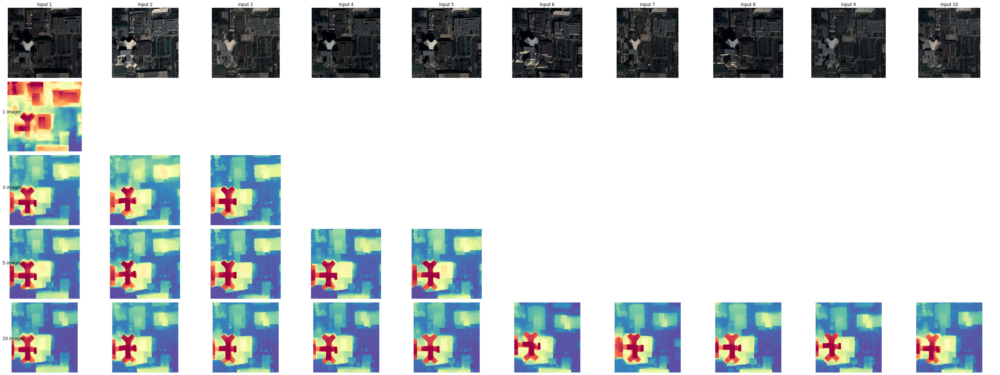

In [15]:
# list all png files in the directory
output_dir = "/workspaces/external_datasets/output"
n_images_list=[1,3,5,10] 
# n_images_list = [1, 3]

# Load *all* images once
all_images, all_image_names = load_img(max(n_images_list), image_folder)

# ---- Create figure ----
n_cols = max(n_images_list)
n_rows = 1 + len(n_images_list)   # 1 row for inputs + 1 per n_images
fig, axes = plt.subplots(
    n_rows, n_cols, 
    figsize=(4 * n_cols, 3 * n_rows)
)

# Ensure 2D axes
if n_rows == 1:
    axes = axes.reshape(1, n_cols)
if n_cols == 1:
    axes = axes.reshape(n_rows, 1)

# ---- Row 0: input images ----
for j in range(n_cols):
    axes[0, j].imshow(all_images[j])
    axes[0, j].axis("off")
    axes[0, j].set_title(f"Input {j+1}")

# ---- Rows for each n_images ----
for i, n_images in enumerate(n_images_list):
    row_id=i+1
    # Select first n_images
    images = all_images[:n_images]

    # Export multiple formats including Gaussian Splatting
    name_output = f"output_{n_images}"
    export_dir = os.path.join(output_dir, name_output)

    prediction = model.inference(
        image=images,
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=export_dir,
        export_format="glb"
    )

    # Plot depth maps for that row
    for j in range(n_cols):
        axes[i+1, j].axis("off")

        if j < n_images:
            depth_vis = visualize_depth(prediction.depth[j], cmap="Spectral")
            axes[i+1, j].imshow(depth_vis)
    
    axes[i+1, 0].set_ylabel(f"{n_images} images", rotation=90, fontsize=12)
    fig.text(
        0.01,
        1 - (row_id + 0.5) / n_rows,   # vertical position
        f"{n_images} image{'s' if n_images > 1 else ''}",
        va="center",
        ha="left",
        fontsize=12
    )

plt.tight_layout()
plt.show()


[WARN ] Images in batch have different sizes [(476, 504), (504, 476), (504, 490)]; center-cropping all to smallest (476,476)
[INFO ] Processed Images Done taking 0.033181190490722656 seconds. Shape:  torch.Size([3, 3, 476, 476])
[INFO ] Model Forward Pass Done. Time: 0.46429991722106934 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0015692710876464844 seconds
[INFO ] conf_thresh_percentile: 40.0
[INFO ] num max points: 1000000
[INFO ] Exporting to GLB with num_max_points: 1000000
[INFO ] Export Results Done. Time: 0.35259270668029785 seconds


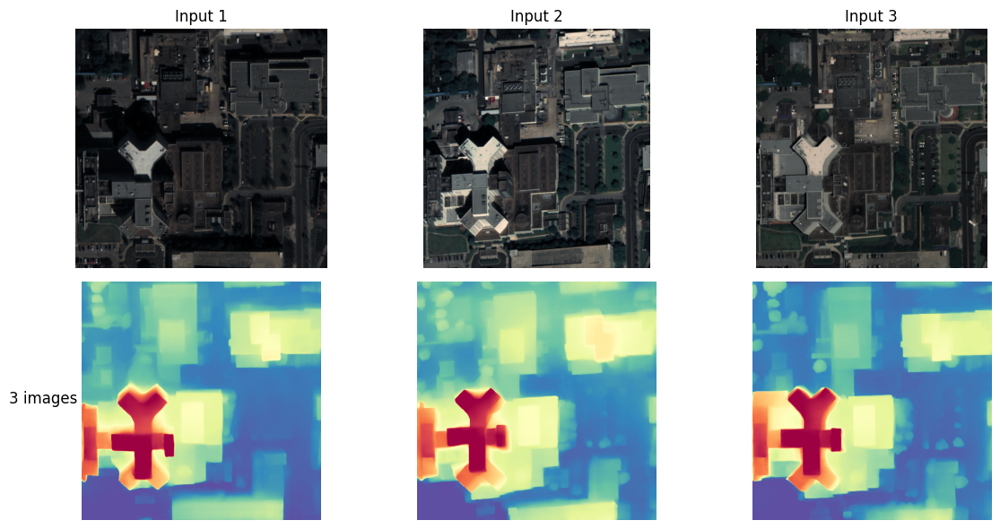

In [16]:
# list all png files in the directory
output_dir = "/workspaces/external_datasets/output"
n_images_list=[3] 
# n_images_list = [1, 3]

# Load *all* images once
all_images, all_image_names = load_img(max(n_images_list), image_folder)

# ---- Create figure ----
n_cols = max(n_images_list)
n_rows = 1 + len(n_images_list)   # 1 row for inputs + 1 per n_images
fig, axes = plt.subplots(
    n_rows, n_cols, 
    figsize=(4 * n_cols, 3 * n_rows)
)

# Ensure 2D axes
if n_rows == 1:
    axes = axes.reshape(1, n_cols)
if n_cols == 1:
    axes = axes.reshape(n_rows, 1)

# ---- Row 0: input images ----
for j in range(n_cols):
    axes[0, j].imshow(all_images[j])
    axes[0, j].axis("off")
    axes[0, j].set_title(f"Input {j+1}")

# ---- Rows for each n_images ----
for i, n_images in enumerate(n_images_list):
    row_id=i+1
    # Select first n_images
    images = all_images[:n_images]

    # Export multiple formats including Gaussian Splatting
    name_output = f"output_{n_images}"
    export_dir = os.path.join(output_dir, name_output)

    prediction = model.inference(
        image=images,
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=export_dir,
        export_format="glb"
    )

    # Plot depth maps for that row
    for j in range(n_cols):
        axes[i+1, j].axis("off")

        if j < n_images:
            depth_vis = visualize_depth(prediction.depth[j], cmap="Spectral")
            axes[i+1, j].imshow(depth_vis)
    
    axes[i+1, 0].set_ylabel(f"{n_images} images", rotation=90, fontsize=12)
    fig.text(
        0.01,
        1 - (row_id + 0.5) / n_rows,   # vertical position
        f"{n_images} image{'s' if n_images > 1 else ''}",
        va="center",
        ha="left",
        fontsize=12
    )

plt.tight_layout()
plt.show()


##  Cas test MAP-free

In [17]:
folder_path="/workspaces/external_datasets/output/sample/sample/test/s00525"
image_folder="/workspaces/external_datasets/output/sample/sample/test/s00525"
import iio 
import os 
import numpy as np
import matplotlib.pyplot as plt
def load_img(n_images, image_folder):
    image_folder=os.path.join(image_folder,"seq1")
    # list all .tif files in the folder
    image_paths = [os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith('.jpg')]
    image_paths
    images=[]
    images_name=[]
    for image_path in image_paths:
        image=iio.read(image_path)
        image = (image).astype(np.uint8) if image.dtype != np.uint8 else image
        images.append(image)
        images_name.append(os.path.basename(image_path))
    # take randomly n_images from images
    idx=np.random.choice(len(images), n_images, replace=False)
    images_sel=[images[i] for i in idx]
    images_name_sel=[images_name[i] for i in idx]
    return images_sel,images_name_sel
import os
import numpy as np
from PIL import Image
import torch

def load_mapfree_scene(scene_dir, seq='seq1', n_images=None):
    """
    Loads up to n_images images from scene, and their intrinsics & extrinsics.
    Assumes dataset structure from the Map-Free benchmark.
    """
    intr_path = os.path.join(scene_dir, 'intrinsics.txt')
    poses_path = os.path.join(scene_dir, 'poses.txt')
    devposes_path = os.path.join(scene_dir, 'poses_device.txt')

    # load intrinsics
    intrinsics_dict = {}
    with open(intr_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            # format: frame_path fx fy cx cy frame_width frame_height
            if len(parts) >= 7:
                fname = parts[0]
                fx, fy, cx, cy = map(float, parts[1:5])
                fname=fname.split("/")[-1]
                intrinsics_dict[fname] = (fx, fy, cx, cy)

    # load extrinsics (world-to-camera; quaternion + translation)
    extrinsics_dict = {}
    with open(poses_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) >= 8:
                fname = parts[0]
                fname=fname.split("/")[-1]
                qw, qx, qy, qz = map(float, parts[1:5])
                tx, ty, tz = map(float, parts[5:8])
                extrinsics_dict[fname] = (qw, qx, qy, qz, tx, ty, tz)

    # list images
    seq_dir = os.path.join(scene_dir, seq)
    img_files = sorted([f for f in os.listdir(seq_dir) if f.lower().endswith(('.jpg','.png','.jpeg'))])
    if n_images is not None:
        # randomly select n_images
        np.random.seed(42)
        np.random.shuffle(img_files)
        
        img_files = img_files[:n_images]

    images = []
    K_list = []
    E_list = []
    for fname in img_files:
        img_path = os.path.join(seq_dir, fname)
        img = Image.open(img_path).convert('RGB')
        images.append(np.array(img))

        # get intrinsics
        fx, fy, cx, cy = intrinsics_dict[fname]
        H, W = img.size[1], img.size[0]
        K = np.array([[fx,  0, cx],
                      [ 0, fy, cy],
                      [ 0,  0,  1]], dtype=float)
        K_list.append(K)

        # get extrinsics (W2C). Convert to C2W if needed.
        qw, qx, qy, qz, tx, ty, tz = extrinsics_dict[fname]
        # quaternion to rotation matrix
        q = np.array([qw, qx, qy, qz], dtype=float)
        q_norm = q / np.linalg.norm(q)
        qw, qx, qy, qz = q_norm
        R = np.array([
            [1-2*qy*qy-2*qz*qz,   2*qx*qy-2*qz*qw,   2*qx*qz+2*qy*qw],
            [2*qx*qy+2*qz*qw,     1-2*qx*qx-2*qz*qz, 2*qy*qz-2*qx*qw],
            [2*qx*qz-2*qy*qw,     2*qy*qz+2*qx*qw,   1-2*qx*qx-2*qy*qy]
        ], dtype=float)
        t = np.array([tx, ty, tz], dtype=float).reshape(3,)

        # W2C: X_c = R * X_w + t
        # For C2W: X_w = R^T * (X_c - t)
        R_c2w = R.T
        t_c2w = -R.T @ t

        E = np.eye(4, dtype=float)
        E[:3, :3] = R_c2w
        E[:3, 3]  = t_c2w
        E_list.append(E)

   
    K_arr   = np.stack(K_list,   axis=0)
    E_arr   = np.stack(E_list,   axis=0)

    return images, K_arr, E_arr

# Example usage:
scene_folder = "/workspaces/external_datasets/output/sample/sample/test/s00525"
images, Ks, C2Ws = load_mapfree_scene(scene_folder, seq='seq1', n_images=10)

# convert to torch tensors
Ks_torch    = torch.from_numpy(Ks).float()[None]              # shape (1, N, 3, 3)
C2Ws_torch  = torch.from_numpy(C2Ws).float()[None]            

In [18]:
model_dir = "depth-anything/DA3NESTED-GIANT-LARGE"
model = DepthAnything3.from_pretrained(model_dir)
model = model.to("cuda").eval()
# Example usage:
scene_folder = "/workspaces/external_datasets/output/sample/sample/test/s00525"


[INFO ] using SwiGLU layer as FFN
[INFO ] using MLP layer as FFN


images  1
[INFO ] Processed Images Done taking 0.021019697189331055 seconds. Shape:  torch.Size([1, 3, 504, 378])
[INFO ] Model Forward Pass Done. Time: 0.18342113494873047 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0009720325469970703 seconds
images  5
[INFO ] Processed Images Done taking 0.02958989143371582 seconds. Shape:  torch.Size([5, 3, 504, 378])
[INFO ] Model Forward Pass Done. Time: 0.5654187202453613 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0016252994537353516 seconds
images  10
[INFO ] Processed Images Done taking 0.034507036209106445 seconds. Shape:  torch.Size([10, 3, 504, 378])
[INFO ] Model Forward Pass Done. Time: 1.138960361480713 seconds
[INFO ] Conversion to Prediction Done. Time: 0.005142927169799805 seconds


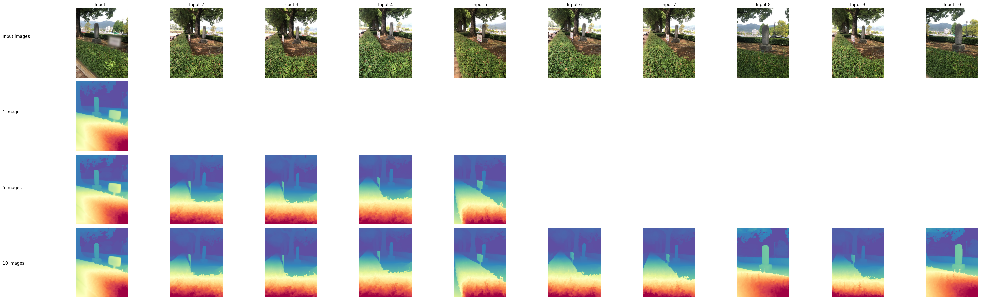

In [19]:
n_images_list = [1, 5, 10]

# Load *all* images once using the largest number
images_max, Ks_max, C2Ws_max = load_mapfree_scene(
    scene_folder, seq='seq1', n_images=max(n_images_list)
)

n_cols = max(n_images_list)
n_rows = 1 + len(n_images_list)   # input row + depth rows

fig, axes = plt.subplots(
    n_rows, n_cols,
    figsize=(4 * n_cols, 3 * n_rows)
)

# Ensure 2D axes
if n_rows == 1:
    axes = axes.reshape(1, n_cols)
if n_cols == 1:
    axes = axes.reshape(n_rows, 1)

# ------------------------------------------------------
# Row 0 : Input images (max number)
# ------------------------------------------------------
for j in range(n_cols):
    axes[0, j].imshow(images_max[j])
    axes[0, j].axis("off")
    axes[0, j].set_title(f"Input {j+1}")

# Caption for row 0
fig.text(
    0.01,
    1 - (0 + 0.5) / n_rows,
    "Input images",
    va="center",
    ha="left",
    fontsize=12
)

# ------------------------------------------------------
# Rows for {1, 5, 10} images
# ------------------------------------------------------
for i, n_images in enumerate(n_images_list):
    row_id = i + 1

    # Subset
    images, Ks, C2Ws = load_mapfree_scene(
        scene_folder, seq='seq1', n_images=n_images
    )

    print("images ", len(images))

    # Run model
    prediction = model.inference(
        image=images,
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )

    # Plot depth outputs
    for j in range(n_cols):
        axes[row_id, j].axis("off")

        if j < n_images:
            depth_vis = visualize_depth(prediction.depth[j], cmap="Spectral")
            axes[row_id, j].imshow(depth_vis)

    # Left-side caption
    fig.text(
        0.01,
        1 - (row_id + 0.5) / n_rows,
        f"{n_images} image{'s' if n_images > 1 else ''}",
        va="center",
        ha="left",
        fontsize=12
    )

plt.tight_layout(rect=[0.06, 0, 1, 1])
plt.show()


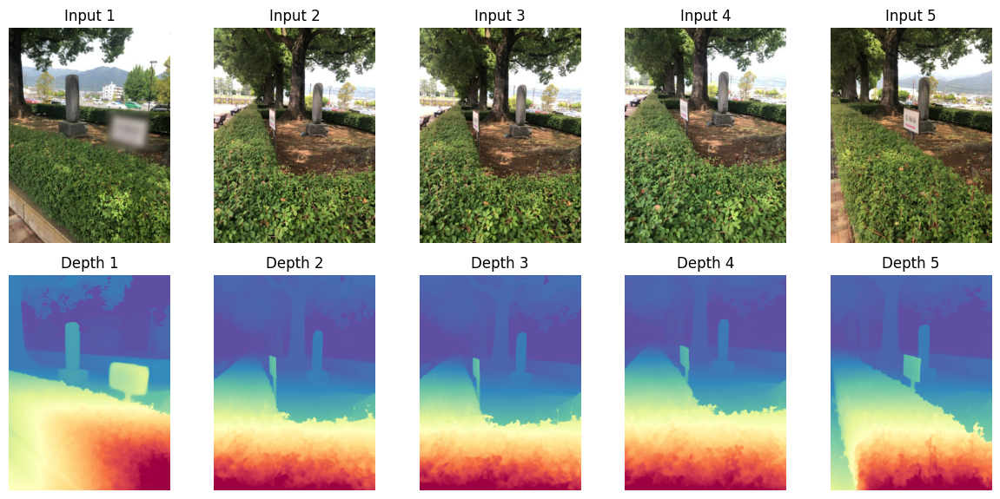

In [20]:
plot_pred(prediction)

# Retrouver les détails du premier ou au dernier plan? 

## Montmartee case

In [21]:
path_folder_montmartre="/workspaces/Depth-Anything-3/data/montmartre"

In [22]:
model_name="depth-anything/DA3NESTED-GIANT-LARGE"

In [23]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
n_images=2
model = DepthAnything3.from_pretrained(model_name)
model = model.to(device)
model.eval()

[INFO ] using SwiGLU layer as FFN
[INFO ] using MLP layer as FFN


DepthAnything3(
  (model): NestedDepthAnything3Net(
    (da3): DepthAnything3Net(
      (backbone): DinoV2(
        (pretrained): DinoVisionTransformer(
          (patch_embed): PatchEmbed(
            (proj): Conv2d(3, 1536, kernel_size=(14, 14), stride=(14, 14))
            (norm): Identity()
          )
          (rope): RotaryPositionEmbedding2D()
          (blocks): ModuleList(
            (0-12): 13 x Block(
              (norm1): LayerNorm((1536,), eps=1e-06, elementwise_affine=True)
              (attn): Attention(
                (qkv): Linear(in_features=1536, out_features=4608, bias=True)
                (q_norm): Identity()
                (k_norm): Identity()
                (attn_drop): Dropout(p=0.0, inplace=False)
                (proj): Linear(in_features=1536, out_features=1536, bias=True)
                (proj_drop): Dropout(p=0.0, inplace=False)
              )
              (ls1): LayerScale(1536, init_values=1.0, inplace=False)
              (drop_path1): Identity

In [24]:
def plot_pred(prediction,title=None,cmap="Spectral"):
    n_images=min(5, len(prediction.depth))

    fig, axes = plt.subplots(2, n_images, figsize=(12, 6))
    if n_images == 1:
        axes = axes.reshape(2, 1)


    for i in range(n_images):
        # Show original image
        if prediction.processed_images is not None:
            axes[0, i].imshow(prediction.processed_images[i])
        axes[0, i].set_title(f"Input {i+1}")
        axes[0, i].axis('off')
        
        # Show depth map
        depth_vis = visualize_depth(prediction.depth[i], cmap=cmap)
        axes[1, i].imshow(depth_vis)
        axes[1, i].set_title(f"Depth {i+1}")
        axes[1, i].axis('off')

    fig.suptitle(title)
    plt.tight_layout()
    plt.show()
visualize_image=plot_pred

Model loaded on cuda
image_paths /workspaces/Depth-Anything-3/data/montmartre/really_crowded.jpg
[INFO ] Processed Images Done taking 0.02270340919494629 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.16239309310913086 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0006384849548339844 seconds


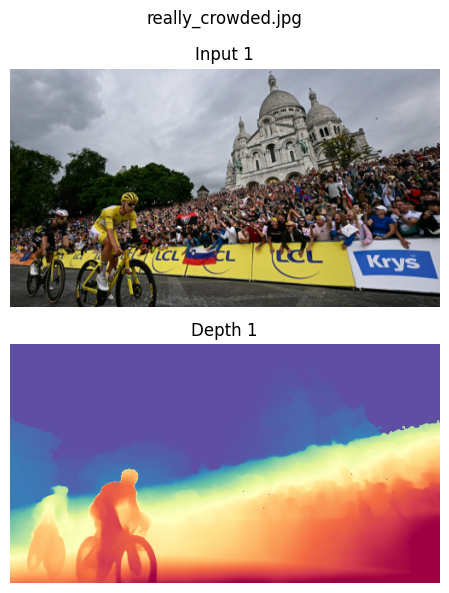

image_paths /workspaces/Depth-Anything-3/data/montmartre/ab_bit_more_crowded.jpg
[INFO ] Processed Images Done taking 0.019644498825073242 seconds. Shape:  torch.Size([1, 3, 378, 504])
[INFO ] Model Forward Pass Done. Time: 0.19547152519226074 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0010523796081542969 seconds


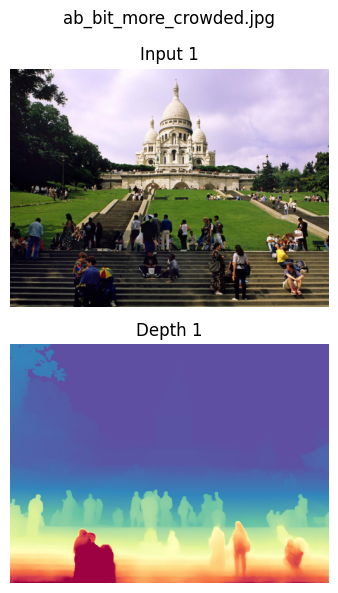

image_paths /workspaces/Depth-Anything-3/data/montmartre/montmartre bit crowded.jpg
[INFO ] Processed Images Done taking 0.06177496910095215 seconds. Shape:  torch.Size([1, 3, 336, 504])
[INFO ] Model Forward Pass Done. Time: 0.1745290756225586 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0009601116180419922 seconds


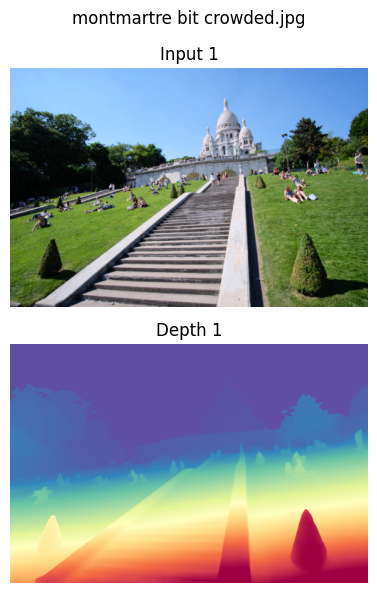

In [25]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from depth_anything_3.api import DepthAnything3
from depth_anything_3.utils.visualize import visualize_depth

import iio 
print(f"Model loaded on {device}")
for image_paths_name in os.listdir(path_folder_montmartre):
    image_paths=os.path.join(path_folder_montmartre,image_paths_name)
    
    image=iio.read(image_paths)
    image = (image).astype(np.uint8) if image.dtype != np.uint8 else image
    print("image_paths",image_paths)
    # Load sample images and run inference


    # Run inference
    prediction = model.inference(
        image=[image],
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )

    visualize_image(prediction=prediction,title=image_paths_name)

[WARN ] Images in batch have different sizes [(280, 504), (378, 504), (336, 504)]; center-cropping all to smallest (280,504)
[INFO ] Processed Images Done taking 0.06295037269592285 seconds. Shape:  torch.Size([3, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.2922511100769043 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0010018348693847656 seconds


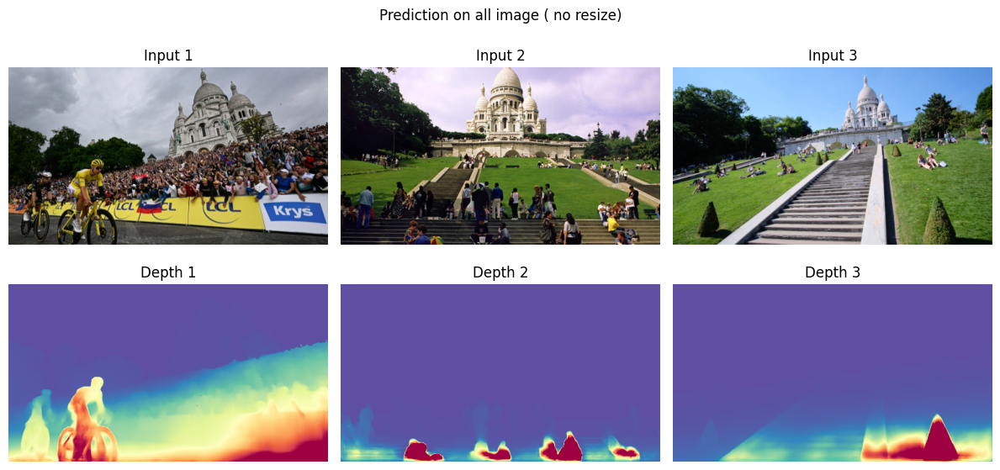

In [26]:
 # same mais On prédit avec toutes les images
image_paths=[]
for image_paths_name in os.listdir(path_folder_montmartre):
    image_paths.append(os.path.join(path_folder_montmartre,image_paths_name))
 # Run inference
# load the image and resize them all to 504 504 

prediction = model.inference(
    image=image_paths,
    process_res=504,
    process_res_method="upper_bound_resize",
    export_dir=None,
    export_format="glb"
)

visualize_image(prediction=prediction,title="Prediction on all image ( no resize)")

[WARN ] Images in batch have different sizes [(378, 504), (336, 504)]; center-cropping all to smallest (336,504)
[INFO ] Processed Images Done taking 0.07523870468139648 seconds. Shape:  torch.Size([2, 3, 336, 504])
[INFO ] Model Forward Pass Done. Time: 0.25492048263549805 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0007817745208740234 seconds


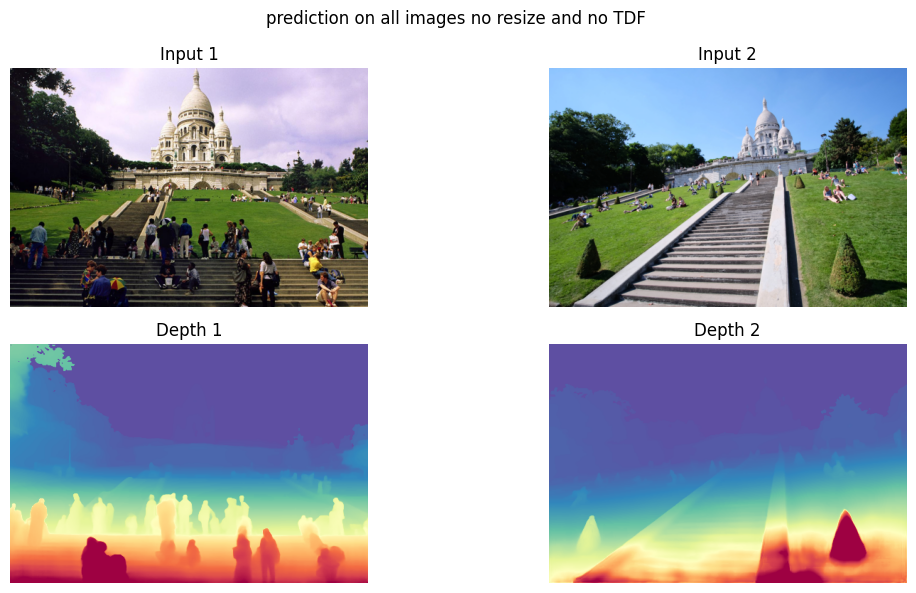

In [27]:
 # same mais On prédit avec toutes les images
image_paths=[]
for image_paths_name in os.listdir(path_folder_montmartre):
    if image_paths_name !="really_crowded.jpg":
        image_paths.append(os.path.join(path_folder_montmartre,image_paths_name))
 # Run inference
# load the image and resize them all to 504 504 

prediction = model.inference(
    image=image_paths,
    process_res=504,
    process_res_method="upper_bound_resize",
    export_dir=None,
    export_format="glb"
)

visualize_image(prediction=prediction,title="prediction on all images no resize and no TDF ")

In [28]:
os.listdir(path_folder_montmartre)

['really_crowded.jpg', 'ab_bit_more_crowded.jpg', 'montmartre bit crowded.jpg']

Loaded 3 images of size (504, 504, 3)
[INFO ] Processed Images Done taking 0.01157999038696289 seconds. Shape:  torch.Size([3, 3, 504, 504])
[INFO ] Model Forward Pass Done. Time: 0.49150681495666504 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0013706684112548828 seconds


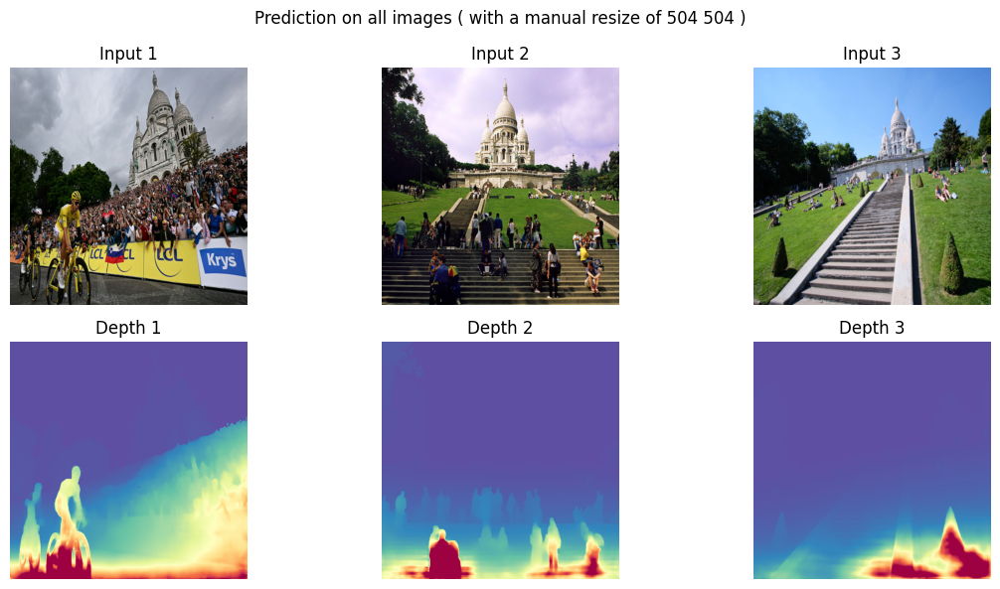

In [29]:
# same mais On prédit avec toutes les images
image_paths = []
for image_paths_name in os.listdir(path_folder_montmartre):
    image_paths.append(os.path.join(path_folder_montmartre, image_paths_name))

# ---- Load & preprocess all images (resize to 504×504) ----
processed_images = []
for p in image_paths:
    img = iio.read(p)
    img = img.astype(np.uint8) if img.dtype != np.uint8 else img

    # Resize to 504×504
    img_resized = np.array(Image.fromarray(img).resize((504, 504)))
    processed_images.append(img_resized)

print(f"Loaded {len(processed_images)} images of size {processed_images[0].shape}")

# ---- Run inference ----
prediction = model.inference(
    image=processed_images,              # pre-resized images
    process_res=504,
    process_res_method="upper_bound_resize",
    export_dir=None,
    export_format="glb"
)

# ---- Display ----
visualize_image(prediction=prediction, title="Prediction on all images ( with a manual resize of 504 504 )")

images  1
[INFO ] Processed Images Done taking 0.012286901473999023 seconds. Shape:  torch.Size([1, 3, 504, 378])
[INFO ] Model Forward Pass Done. Time: 0.16724324226379395 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0005605220794677734 seconds
images  3
[INFO ] Processed Images Done taking 0.02498316764831543 seconds. Shape:  torch.Size([3, 3, 504, 378])
[INFO ] Model Forward Pass Done. Time: 0.3708951473236084 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0011456012725830078 seconds


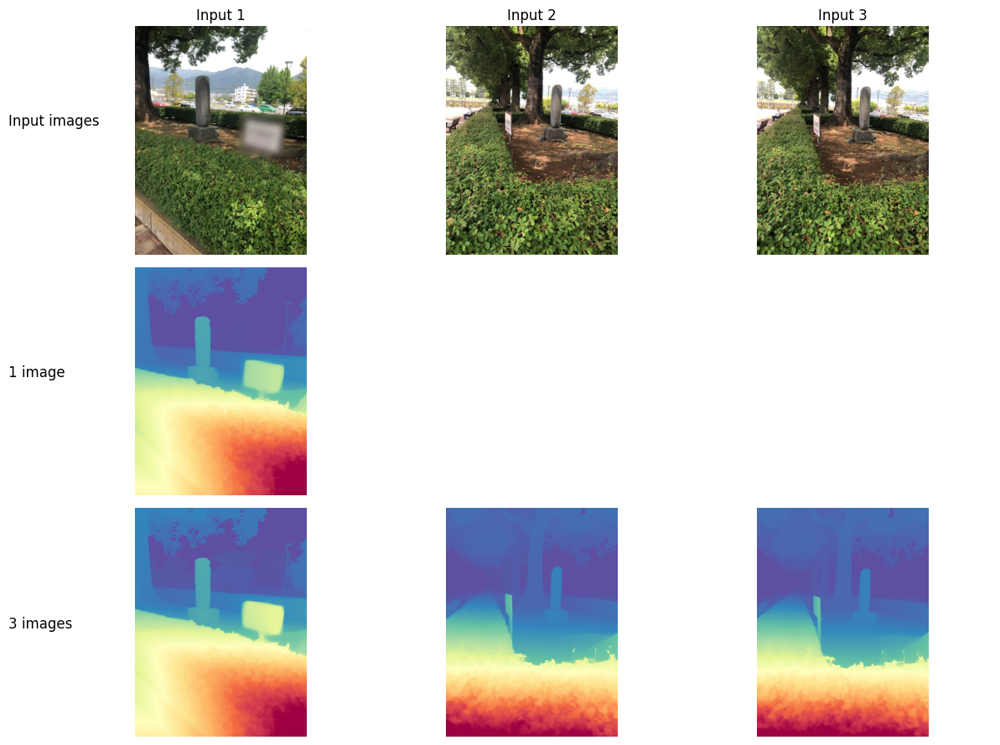

In [30]:
n_images_list = [1,3]

# Load *all* images once using the largest number
images_max, Ks_max, C2Ws_max = load_mapfree_scene(
    scene_folder, seq='seq1', n_images=max(n_images_list)
)

n_cols = max(n_images_list)
n_rows = 1 + len(n_images_list)   # input row + depth rows

fig, axes = plt.subplots(
    n_rows, n_cols,
    figsize=(4 * n_cols, 3 * n_rows)
)

# Ensure 2D axes
if n_rows == 1:
    axes = axes.reshape(1, n_cols)
if n_cols == 1:
    axes = axes.reshape(n_rows, 1)

# ------------------------------------------------------
# Row 0 : Input images (max number)
# ------------------------------------------------------
for j in range(n_cols):
    axes[0, j].imshow(images_max[j])
    axes[0, j].axis("off")
    axes[0, j].set_title(f"Input {j+1}")

# Caption for row 0
fig.text(
    0.01,
    1 - (0 + 0.5) / n_rows,
    "Input images",
    va="center",
    ha="left",
    fontsize=12
)

# ------------------------------------------------------
# Rows for {1, 5, 10} images
# ------------------------------------------------------
for i, n_images in enumerate(n_images_list):
    row_id = i + 1

    # Subset
    images, Ks, C2Ws = load_mapfree_scene(
        scene_folder, seq='seq1', n_images=n_images
    )

    print("images ", len(images))

    # Run model
    prediction = model.inference(
        image=images,
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )

    # Plot depth outputs
    for j in range(n_cols):
        axes[row_id, j].axis("off")

        if j < n_images:
            depth_vis = visualize_depth(prediction.depth[j], cmap="Spectral")
            axes[row_id, j].imshow(depth_vis)

    # Left-side caption
    fig.text(
        0.01,
        1 - (row_id + 0.5) / n_rows,
        f"{n_images} image{'s' if n_images > 1 else ''}",
        va="center",
        ha="left",
        fontsize=12
    )

plt.tight_layout(rect=[0.06, 0, 1, 1])
plt.show()


### Dronesplat case

In [31]:
# on run ici sur dronesplat

path_folder_dronesplat="/workspaces/Depth-Anything-3/data/Dronesplat"

In [32]:
model_name="depth-anything/DA3NESTED-GIANT-LARGE"

In [33]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
n_images=2
model = DepthAnything3.from_pretrained(model_name)
model = model.to(device)
model.eval()

[INFO ] using SwiGLU layer as FFN
[INFO ] using MLP layer as FFN


DepthAnything3(
  (model): NestedDepthAnything3Net(
    (da3): DepthAnything3Net(
      (backbone): DinoV2(
        (pretrained): DinoVisionTransformer(
          (patch_embed): PatchEmbed(
            (proj): Conv2d(3, 1536, kernel_size=(14, 14), stride=(14, 14))
            (norm): Identity()
          )
          (rope): RotaryPositionEmbedding2D()
          (blocks): ModuleList(
            (0-12): 13 x Block(
              (norm1): LayerNorm((1536,), eps=1e-06, elementwise_affine=True)
              (attn): Attention(
                (qkv): Linear(in_features=1536, out_features=4608, bias=True)
                (q_norm): Identity()
                (k_norm): Identity()
                (attn_drop): Dropout(p=0.0, inplace=False)
                (proj): Linear(in_features=1536, out_features=1536, bias=True)
                (proj_drop): Dropout(p=0.0, inplace=False)
              )
              (ls1): LayerScale(1536, init_values=1.0, inplace=False)
              (drop_path1): Identity

Model loaded on cuda
image_paths /workspaces/Depth-Anything-3/data/Dronesplat/2411006_18_014.jpg
[INFO ] Processed Images Done taking 0.040415048599243164 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13625884056091309 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0006773471832275391 seconds
Depth shape: (1, 280, 504)
Extrinsics: (1, 3, 4)
Intrinsics: (1, 3, 3)


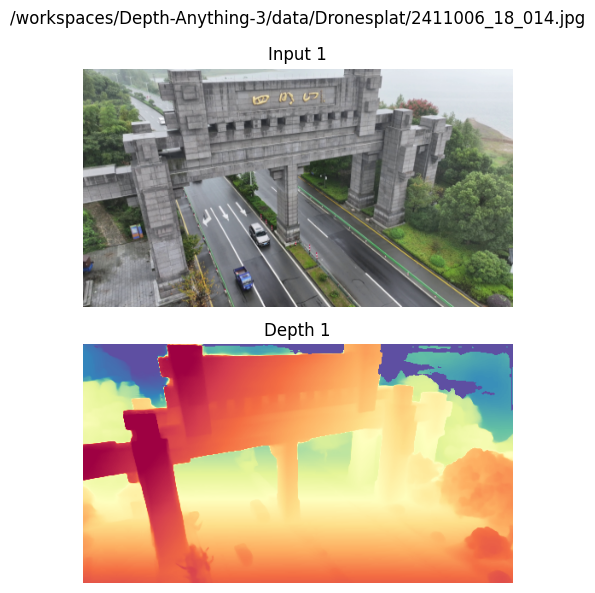

image_paths /workspaces/Depth-Anything-3/data/Dronesplat/2411006_18_023.jpg
[INFO ] Processed Images Done taking 0.043016672134399414 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13483762741088867 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0004551410675048828 seconds
Depth shape: (1, 280, 504)
Extrinsics: (1, 3, 4)
Intrinsics: (1, 3, 3)


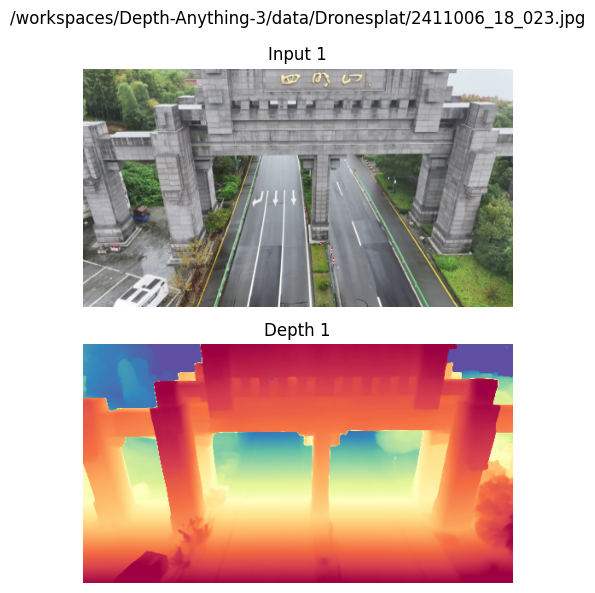

image_paths /workspaces/Depth-Anything-3/data/Dronesplat/2411006_18_016.jpg
[INFO ] Processed Images Done taking 0.03926515579223633 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13633418083190918 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0004603862762451172 seconds
Depth shape: (1, 280, 504)
Extrinsics: (1, 3, 4)
Intrinsics: (1, 3, 3)


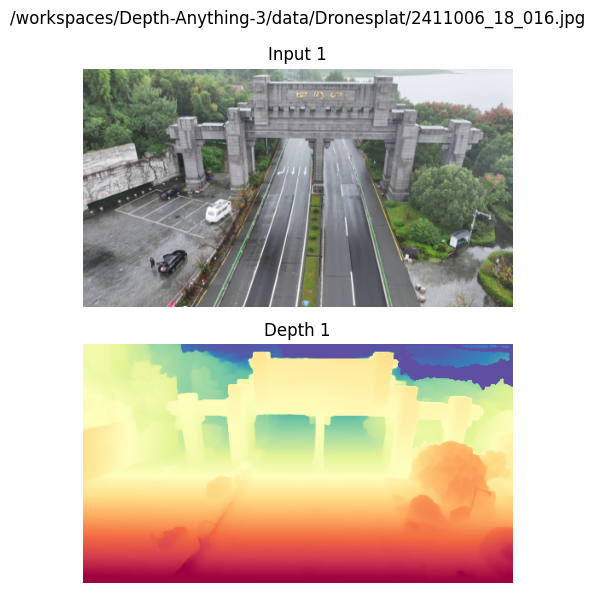

image_paths /workspaces/Depth-Anything-3/data/Dronesplat/2411006_18_004.jpg
[INFO ] Processed Images Done taking 0.04188132286071777 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13419198989868164 seconds
[INFO ] Conversion to Prediction Done. Time: 0.00046563148498535156 seconds
Depth shape: (1, 280, 504)
Extrinsics: (1, 3, 4)
Intrinsics: (1, 3, 3)


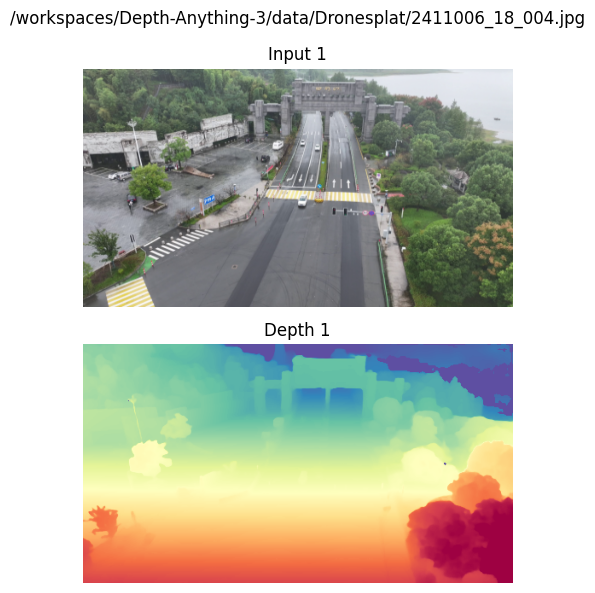

image_paths /workspaces/Depth-Anything-3/data/Dronesplat/2411006_18_018.jpg
[INFO ] Processed Images Done taking 0.027864694595336914 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13460755348205566 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0004467964172363281 seconds
Depth shape: (1, 280, 504)
Extrinsics: (1, 3, 4)
Intrinsics: (1, 3, 3)


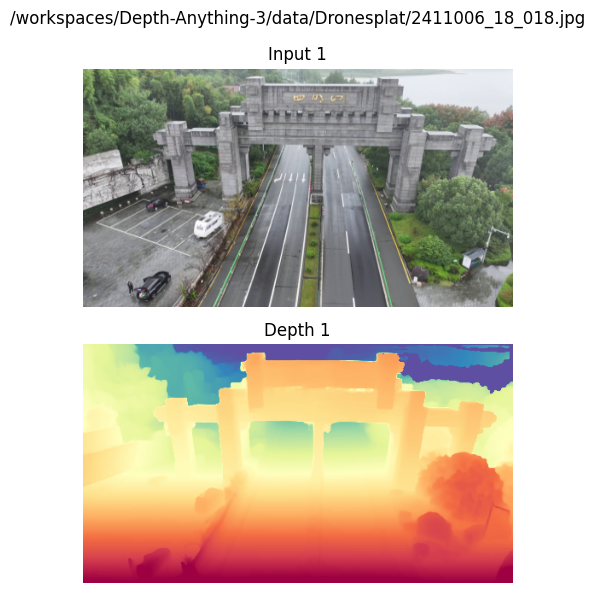

In [34]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from depth_anything_3.api import DepthAnything3
from depth_anything_3.utils.visualize import visualize_depth
import iio
print(f"Model loaded on {device}")
for image_paths_name in os.listdir(path_folder_dronesplat):
    image_paths=os.path.join(path_folder_dronesplat,image_paths_name)
    image=iio.read(image_paths)
    image = (image).astype(np.uint8) if image.dtype != np.uint8 else image
    print("image_paths",image_paths)
    # Load sample images and run inference


    # Run inference
    prediction = model.inference(
        image=[image],
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )
    print(f"Depth shape: {prediction.depth.shape}")
    print(f"Extrinsics: {prediction.extrinsics.shape if prediction.extrinsics is not None else 'None'}")
    print(f"Intrinsics: {prediction.intrinsics.shape if prediction.intrinsics is not None else 'None'}")
    visualize_image(prediction=prediction,title=image_paths)

[INFO ] Processed Images Done taking 0.07110977172851562 seconds. Shape:  torch.Size([5, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.4434382915496826 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0016238689422607422 seconds
Depth shape: (5, 280, 504)
Extrinsics: (5, 3, 4)
Intrinsics: (5, 3, 3)


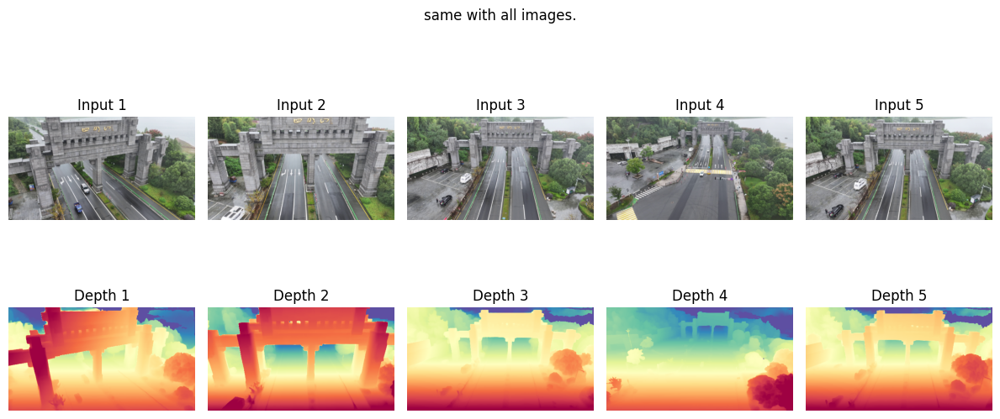

In [35]:
 # same mais On prédit avec toutes les images
image_paths=[]
for image_paths_name in os.listdir(path_folder_dronesplat):
    image_paths.append(os.path.join(path_folder_dronesplat,image_paths_name))
 # Run inference
prediction = model.inference(
    image=image_paths,
    process_res=504,
    process_res_method="upper_bound_resize",
    export_dir=None,
    export_format="glb"
)
print(f"Depth shape: {prediction.depth.shape}")
print(f"Extrinsics: {prediction.extrinsics.shape if prediction.extrinsics is not None else 'None'}")
print(f"Intrinsics: {prediction.intrinsics.shape if prediction.intrinsics is not None else 'None'}")
visualize_image(prediction=prediction,title="same with all images.")

## Adversarial noise

In [36]:
# Test sur l'image de DA3 et on effectue une image adversariale/
sigma=0.1
def add_random_noise(img,mean,sigma=0):
    gaussian = np.random.normal(mean, sigma, img.shape) 
    img=img+gaussian
    return img

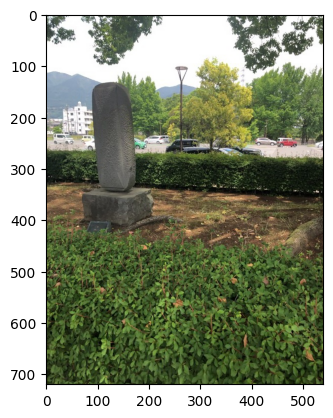

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.36733569497846874..1.4762298870657387].


[[[ 0.71623916  0.78362635  0.58733734]
  [ 0.38123751  0.88098163  0.94765385]
  [ 0.8677019   0.97002949  0.95402046]
  ...
  [ 0.93283634  1.05526251  0.88753318]
  [ 0.88234039  1.09037802  1.06339751]
  [ 0.93264412  1.17188505  0.95168149]]

 [[ 0.47514495  0.5091818   0.53080739]
  [ 0.5212598   0.57089426  0.40784776]
  [ 0.75663396  1.08284345  0.89055344]
  ...
  [ 0.80541478  1.02279297  0.87074653]
  [ 1.09019448  0.85230527  1.01675692]
  [ 1.10642683  0.88908792  0.88636053]]

 [[ 0.32518828  0.42592354  0.47527159]
  [ 0.36677892  0.36241398  0.23341875]
  [ 0.82293985  0.87393192  0.73053351]
  ...
  [ 0.89590921  1.11869407  0.8899343 ]
  [ 0.79351139  1.20337808  1.02464182]
  [ 0.86171477  0.96024348  0.89917704]]

 ...

 [[ 0.30603296  0.21005875  0.22660104]
  [ 0.4005073   0.32270092  0.12095589]
  [-0.06675231  0.23553529 -0.01687311]
  ...
  [ 0.08968999  0.4446089   0.29820016]
  [ 0.19589467  0.33886086  0.02379631]
  [ 0.1841739   0.19221273  0.05023593]]

 [

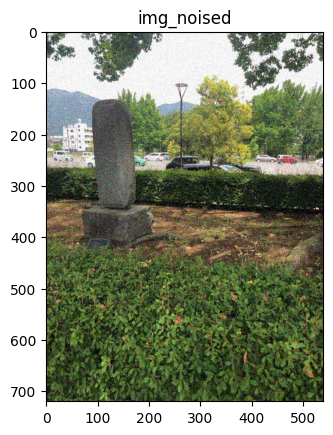

In [37]:
img_path="/workspaces/external_datasets/output/sample/sample/test/s00525/seq1/frame_00105.jpg"
import iio 
img=iio.read(img_path)
img = (img).astype(np.uint8) if img.dtype != np.uint8 else img
img=img/255
plt.imshow(img)
plt.show()
img_noised=add_random_noise(img=img,mean=0,sigma=sigma)
print(img_noised)
plt.imshow(img_noised)
plt.title("img_noised")
plt.show()

[INFO ] Processed Images Done taking 0.01685309410095215 seconds. Shape:  torch.Size([1, 3, 504, 378])
[INFO ] Model Forward Pass Done. Time: 0.1612851619720459 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0006525516510009766 seconds


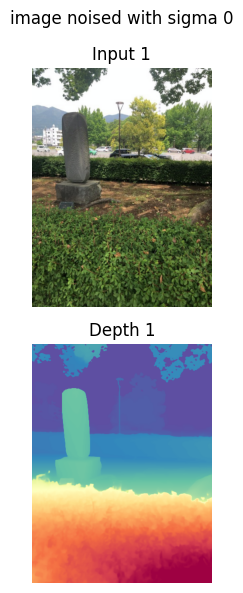

[INFO ] Processed Images Done taking 0.011584043502807617 seconds. Shape:  torch.Size([1, 3, 504, 378])
[INFO ] Model Forward Pass Done. Time: 0.1650104522705078 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0006504058837890625 seconds


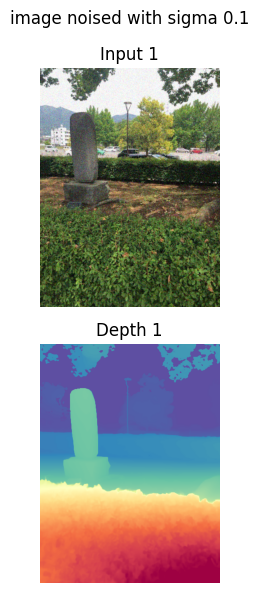

[INFO ] Processed Images Done taking 0.011332511901855469 seconds. Shape:  torch.Size([1, 3, 504, 378])
[INFO ] Model Forward Pass Done. Time: 0.16566753387451172 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0006070137023925781 seconds


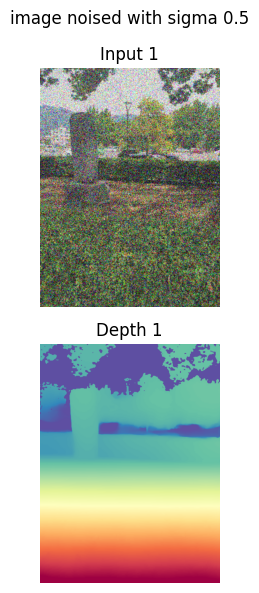

[INFO ] Processed Images Done taking 0.010786056518554688 seconds. Shape:  torch.Size([1, 3, 504, 378])
[INFO ] Model Forward Pass Done. Time: 0.16572046279907227 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0007340908050537109 seconds


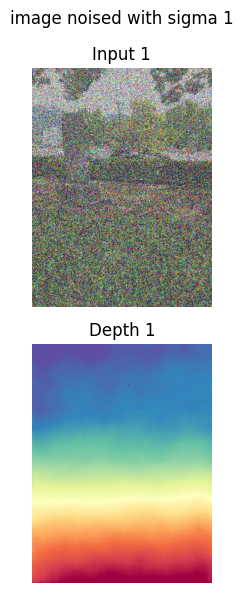

In [38]:
for sigma in [0,0.1,0.5,1]:
    img=iio.read(img_path)
    img = (img).astype(np.uint8) if img.dtype != np.uint8 else img
    img=img/255

    img_noised=add_random_noise(img=img,mean=0,sigma=sigma)
  
    # Load sample images and run inference
    # putit back to 255
    img_noised=(img_noised*255).clip(0,255).astype(np.uint8)

    # # Run inference
    prediction = model.inference(
        image=[img_noised],
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )

    visualize_image(prediction=prediction,title=f"image noised with sigma {sigma}")

# Impact de la résolution
sur Dronesplat

In [39]:
#load ta drone splat image and we downsample the resolution.

In [40]:
img_path=os.path.join(path_folder_dronesplat,os.listdir(path_folder_dronesplat)[0])
img=iio.read(img_path)

In [41]:
!pip install scikit-image

In [42]:
from skimage import data, color
from skimage.transform import rescale, resize, downscale_local_mean


In [43]:
img

array([[[134., 147., 119.],
        [134., 147., 121.],
        [130., 143., 117.],
        ...,
        [239., 244., 248.],
        [238., 243., 247.],
        [238., 243., 247.]],

       [[129., 142., 116.],
        [134., 147., 121.],
        [131., 144., 118.],
        ...,
        [238., 243., 247.],
        [238., 243., 247.],
        [238., 243., 247.]],

       [[124., 137., 111.],
        [128., 141., 115.],
        [125., 137., 113.],
        ...,
        [238., 243., 247.],
        [238., 243., 247.],
        [238., 243., 247.]],

       ...,

       [[ 82.,  78.,  75.],
        [ 72.,  68.,  65.],
        [ 70.,  66.,  63.],
        ...,
        [104., 122.,  72.],
        [101., 116.,  73.],
        [ 87., 102.,  61.]],

       [[ 55.,  50.,  47.],
        [ 48.,  44.,  41.],
        [ 45.,  41.,  38.],
        ...,
        [128., 146.,  96.],
        [119., 134.,  91.],
        [110., 124.,  88.]],

       [[ 51.,  45.,  45.],
        [ 56.,  50.,  50.],
        [ 57.,  

[INFO ] Processed Images Done taking 0.04973745346069336 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.1464853286743164 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0007038116455078125 seconds


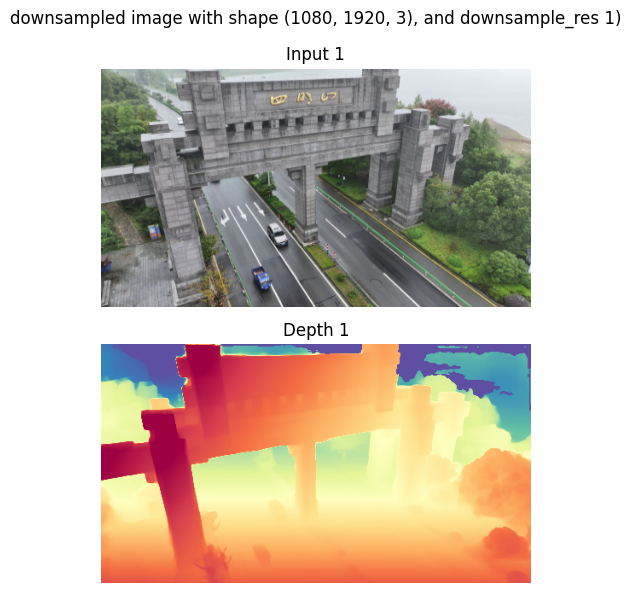

[INFO ] Processed Images Done taking 0.023655414581298828 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13661742210388184 seconds
[INFO ] Conversion to Prediction Done. Time: 0.00048351287841796875 seconds


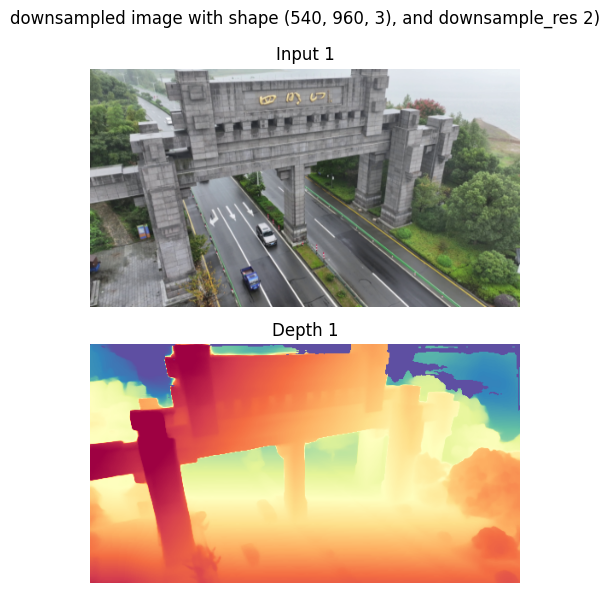

[INFO ] Processed Images Done taking 0.01741337776184082 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13412237167358398 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0005052089691162109 seconds


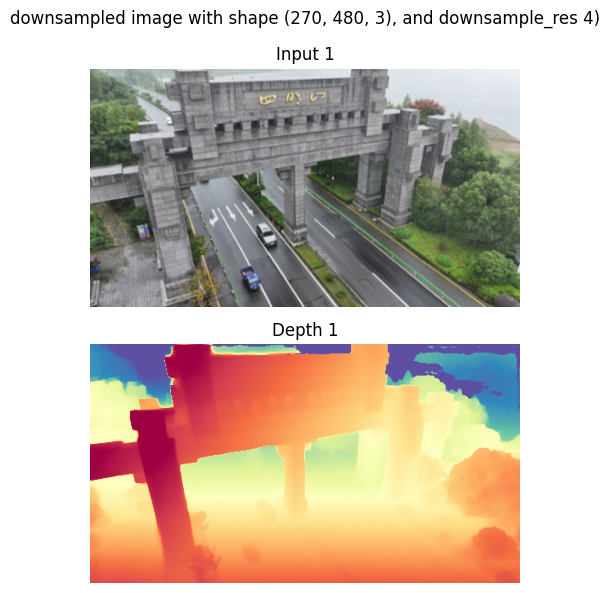

[INFO ] Processed Images Done taking 0.014622926712036133 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13682198524475098 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0004787445068359375 seconds


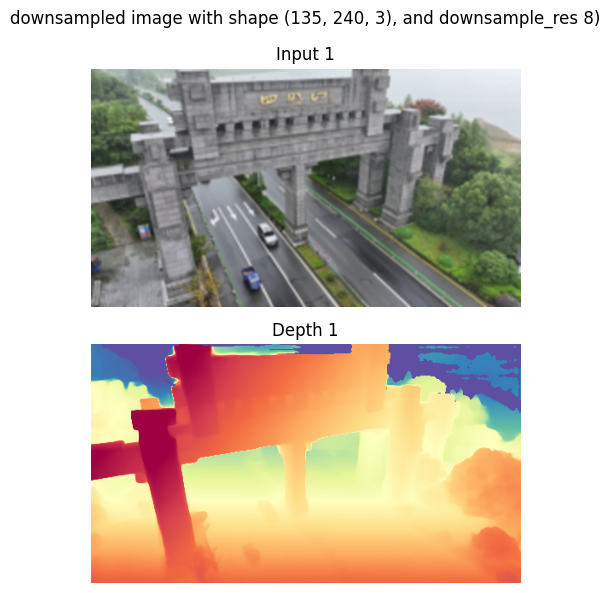

[INFO ] Processed Images Done taking 0.012008428573608398 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13673138618469238 seconds
[INFO ] Conversion to Prediction Done. Time: 0.000476837158203125 seconds


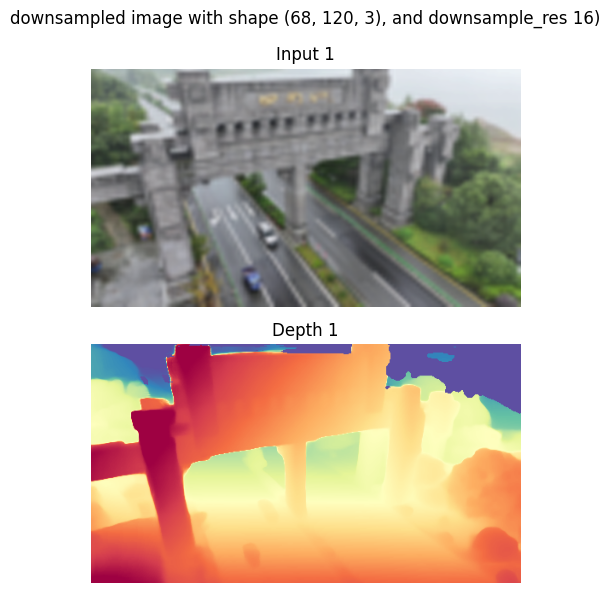

In [44]:
downsample_res=[1,2,4,8,16]
for dowsample in downsample_res:
    # downsample the img
    image_path = os.path.join(path_folder_dronesplat, os.listdir(path_folder_dronesplat)[0])
    image = iio.read(image_path)
    image = image.astype(np.uint8)
    # Downscale image
    img_downscaled = rescale(image, 1 / dowsample, channel_axis=-1)
     # Run inference
    img_downscaled=(img_downscaled*255).clip(0,255).astype(np.uint8)
    prediction = model.inference(
        image=[img_downscaled],
        process_res=504, #?
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )

    visualize_image(prediction=prediction,title=f"downsampled image with shape {img_downscaled.shape}, and downsample_res {dowsample})")

    # shoudln't have a huge impact because the down res is 504 ? 

# Changement d'illumination


[INFO ] Processed Images Done taking 0.027779817581176758 seconds. Shape:  torch.Size([1, 3, 378, 504])
[INFO ] Model Forward Pass Done. Time: 0.16413497924804688 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0006184577941894531 seconds


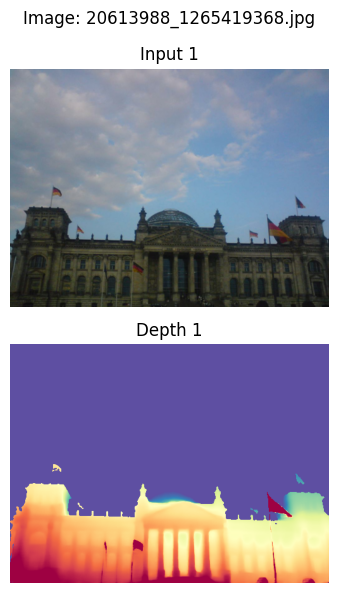

[INFO ] Processed Images Done taking 0.017037391662597656 seconds. Shape:  torch.Size([1, 3, 280, 504])
[INFO ] Model Forward Pass Done. Time: 0.13862824440002441 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0005173683166503906 seconds


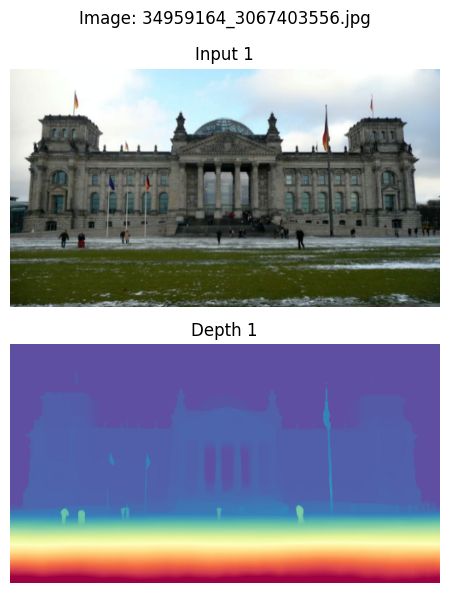

[INFO ] Processed Images Done taking 0.022485971450805664 seconds. Shape:  torch.Size([1, 3, 266, 504])
[INFO ] Model Forward Pass Done. Time: 0.1519794464111328 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0004863739013671875 seconds


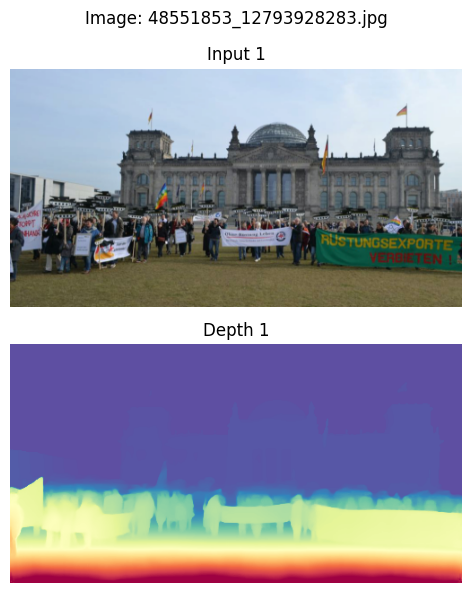

[INFO ] Processed Images Done taking 0.02570366859436035 seconds. Shape:  torch.Size([1, 3, 322, 504])
[INFO ] Model Forward Pass Done. Time: 0.17244863510131836 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0005686283111572266 seconds


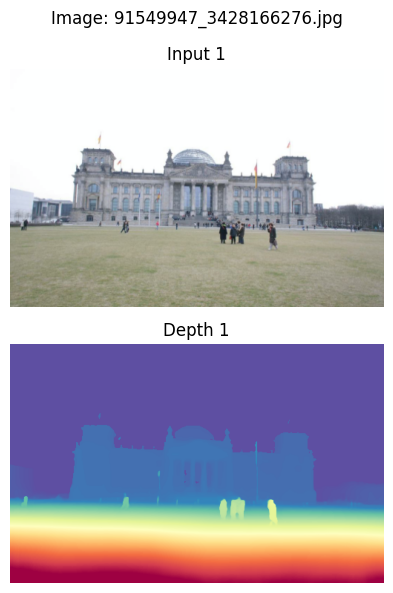

[INFO ] Processed Images Done taking 0.013617992401123047 seconds. Shape:  torch.Size([1, 3, 238, 504])
[INFO ] Model Forward Pass Done. Time: 0.15510010719299316 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0004444122314453125 seconds


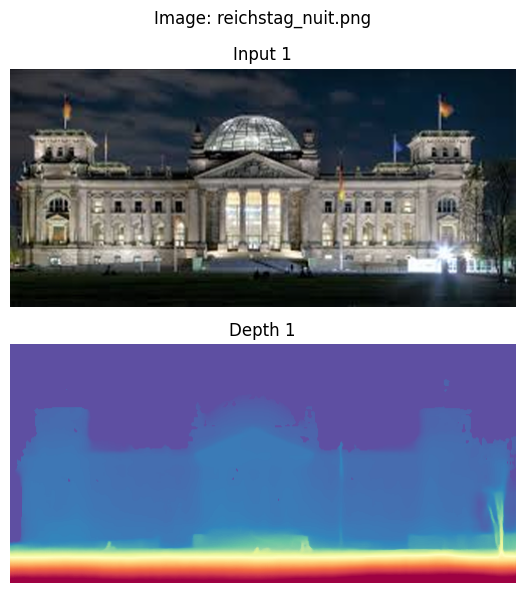

In [45]:
images_path = [
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/20613988_1265419368.jpg",   # faible illumination
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/34959164_3067403556.jpg",   # normal front daylight, neige
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/48551853_12793928283.jpg",  # manif front illum
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/91549947_3428166276.jpg",   # weird illumination
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/reichstag_nuit.png"
]

for img_path in images_path:
    img = iio.read(img_path).astype(np.uint8)

    prediction = model.inference(
        image=[img],
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )

    visualize_image(
        prediction=prediction,
        title=f"Image: {os.path.basename(img_path)}"
    )

[INFO ] Processed Images Done taking 0.24622797966003418 seconds. Shape:  torch.Size([1, 3, 196, 504])
[INFO ] Model Forward Pass Done. Time: 0.1376805305480957 seconds
[INFO ] Conversion to Prediction Done. Time: 0.00039649009704589844 seconds


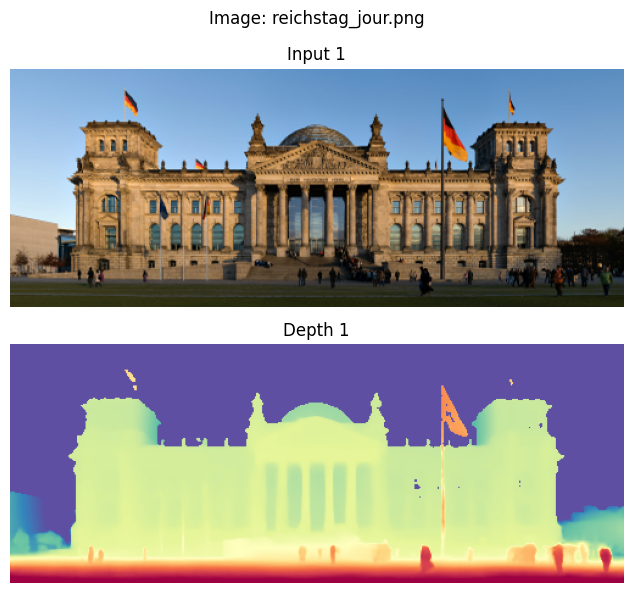

[INFO ] Processed Images Done taking 0.011359453201293945 seconds. Shape:  torch.Size([1, 3, 336, 504])
[INFO ] Model Forward Pass Done. Time: 0.15648674964904785 seconds
[INFO ] Conversion to Prediction Done. Time: 0.000675201416015625 seconds


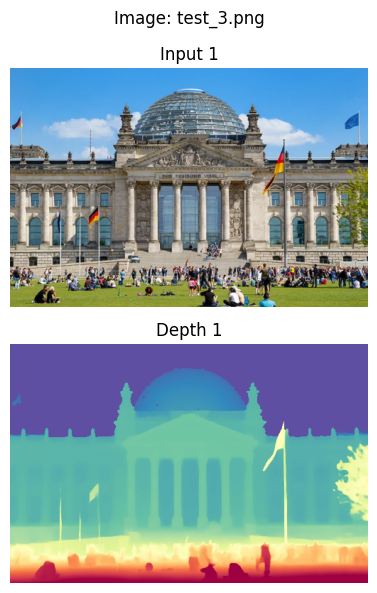

[INFO ] Processed Images Done taking 0.008652210235595703 seconds. Shape:  torch.Size([1, 3, 238, 504])
[INFO ] Model Forward Pass Done. Time: 0.11797189712524414 seconds
[INFO ] Conversion to Prediction Done. Time: 0.000457763671875 seconds


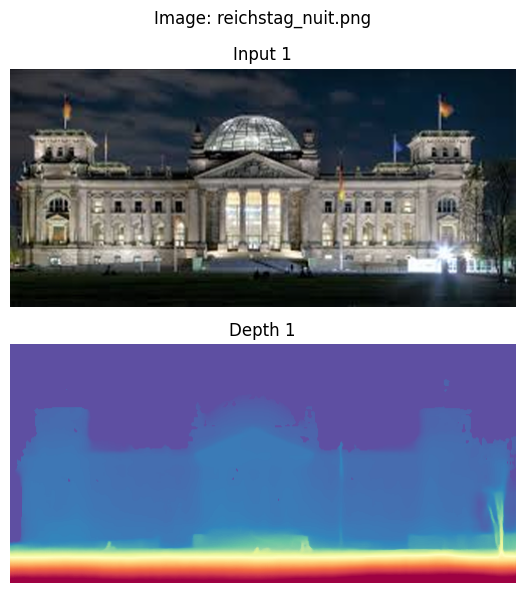

[INFO ] Processed Images Done taking 0.013862371444702148 seconds. Shape:  torch.Size([1, 3, 364, 504])
[INFO ] Model Forward Pass Done. Time: 0.18427515029907227 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0005652904510498047 seconds


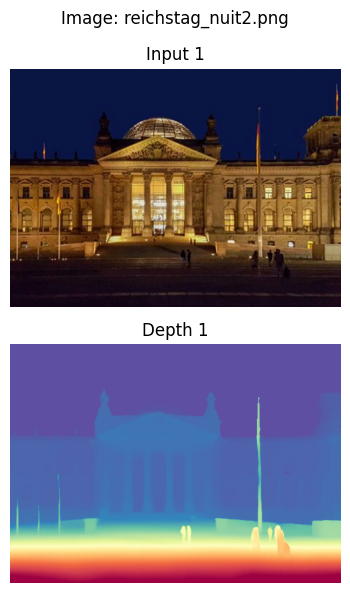

In [46]:
images_path = [
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/reichstag_jour.png",
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/test_3.png",
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/reichstag_nuit.png",
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/reichstag_nuit2.png"
]

for img_path in images_path:
    img = iio.read(img_path).astype(np.uint8)

    prediction = model.inference(
        image=[img],
        process_res=504,
        process_res_method="upper_bound_resize",
        export_dir=None,
        export_format="glb"
    )

    visualize_image(
        prediction=prediction,
        title=f"Image: {os.path.basename(img_path)}"
    )

[WARN ] Images in batch have different sizes [(196, 504), (336, 504), (238, 504), (364, 504)]; center-cropping all to smallest (196,504)
[INFO ] Processed Images Done taking 0.6446719169616699 seconds. Shape:  torch.Size([4, 3, 196, 504])
[INFO ] Model Forward Pass Done. Time: 0.2695901393890381 seconds
[INFO ] Conversion to Prediction Done. Time: 0.0008668899536132812 seconds


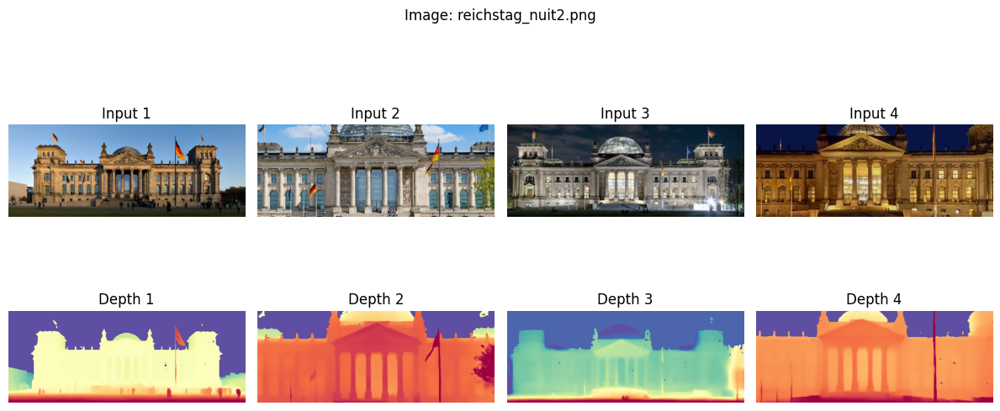

In [47]:
images_path = [
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/reichstag_jour.png",
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/test_3.png",
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/reichstag_nuit.png",
    "/workspaces/Depth-Anything-3/data/reichstag/dense/images/reichstag_nuit2.png"
]

prediction = model.inference(
    image=images_path,
    process_res=504,
    process_res_method="upper_bound_resize",
    export_dir=None,
    export_format="glb"
)

visualize_image(
    prediction=prediction,
    title=f"Image: {os.path.basename(img_path)}"
)